<a href="https://colab.research.google.com/github/CrystalParaboy/cuhk-gis-bigdata/blob/main/Tutorial_3_ipynb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1 Clustering on spatial data


In [ ]:
!pip install sklearn # an important machine learning package

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for sklearn: filename=sklearn-0.0.post1-py3-none-any.whl size=2955 sha256=b94707a34ee871c5aed22dee79b11a92018aa4da138c3953ec5cd456a5eb13c6
  Stored in directory: /root/.cache/pip/wheels/f8/e0/3d/9d0c2020c44a519b9f02ab4fa6d2a4a996c98d79ab2f569fa1
Successfully built sklearn


In [ ]:
# Generate some random coordinates at Shanghai
import numpy as np
import pandas as pd

from sklearn.datasets import make_blobs

sh_lat = 31.22 
sh_lng = 121.46

data, label = make_blobs(n_samples=100, n_features=2, centers=5) # five clusters, randomly

sample_data =pd.DataFrame(data = data*0.01 + np.array([sh_lat,sh_lng]),  
                  columns = ["y", "x"]) 

sample_data.head(10) # show the top rows

,y,x
0,31.276162,121.508491
1,31.297679,121.508366
2,31.268609,121.506954
3,31.252169,121.526382
4,31.112929,121.398098
5,31.297640,121.491976
6,31.241765,121.523199
7,31.258044,121.528017
8,31.118302,121.381932
9,31.274307,121.502558


In [ ]:
# plot in map
!pip install folium
import folium

gaode = 'http://wprd03.is.autonavi.com/appmaptile?style=7&x={x}&y={y}&z={z}' 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## 1.3 Shared bike O-D

In [ ]:
# load a mobike data in Shanghai
mobike_df = pd.read_csv('https://github.com/gyshion/tutorial/raw/main/mobike_shanghai1.csv')
mobike_df

,orderid,bikeid,userid,start_time,start_location_x,start_location_y,end_time,end_location_x,end_location_y,track
0,78387,158357,10080,2016-08-20 06:57,121.34860,31.38844,2016-08-20 07:04,121.35731,31.38846,NaN
1,891333,92776,6605,2016-08-29 19:09,121.50808,31.27989,2016-08-29 19:31,121.48925,31.27156,NaN
2,1106623,152045,8876,2016-08-13 16:17,121.38256,31.25409,2016-08-13 16:36,121.40445,31.24789,NaN
3,1389484,196259,10648,2016-08-23 21:34,121.48472,31.31914,2016-08-23 21:43,121.47078,31.32401,NaN
4,188537,78208,11735,2016-08-16 07:32,121.40655,31.29142,2016-08-16 07:41,121.41701,31.28734,NaN
...,...,...,...,...,...,...,...,...,...,...
102356,1479550,214335,1423,2016-08-28 18:03,121.47716,31.29627,2016-08-28 18:09,121.48110,31.30321,NaN
102357,1478273,160487,3067,2016-08-14 20:22,121.32073,31.23861,2016-08-14 20:28,121.31166,31.23460,NaN
102358,367733,179530,12746,2016-08-27 09:54,121.39125,31.30636,2016-08-27 10:06,121.39788,31.30559,NaN
102359,64915,167419,837,2016-08-20 06:04,121.51414,31.26882,2016-08-20 06:10,121.50941,31.27181,NaN


In [ ]:
# Plot 1% of the Origin-destination line from mobike data

map_sh = folium.Map(location=[sh_lat,sh_lng],tiles=gaode, attr = 'shared bike')

for index, row in mobike_df.iterrows():
    #if index%100 == 0: # 100, 200, 300 ...
    if index%10 == 0: # 10%
        OD = [
            [row['start_location_y'],row['start_location_x']],
            [row['end_location_y'],row['end_location_x']]]
        
        folium.PolyLine(OD, color='red').add_to(map_sh)
map_sh

## 1.4 Try DBscan on Mobike dataset

In [ ]:
# stack the origin points with destination points
new_ll = []

for index, row in mobike_df.iterrows():
    new_ll.append([row['start_location_y'],row['start_location_x']])
    new_ll.append([row['end_location_y'],row['end_location_x']])

all_pt =pd.DataFrame(data = new_ll, columns = ["y", "x"]) 

all_pt.head(5) # plot 5 rows

,y,x
0,31.38844,121.34860
1,31.38846,121.35731
2,31.27989,121.50808
3,31.27156,121.48925
4,31.25409,121.38256


In [ ]:
db_mobike = DBSCAN(eps = 0.0005, # ~ 50 meter
                   min_samples = 20).fit(all_pt[['y','x']]) # train the model 

In [ ]:
predict_mobike = db_mobike.fit_predict(all_pt[['y','x']]) # predict by the model
all_pt['label'] = predict_mobike

all_pt

,y,x,label
0,31.38844,121.34860,-1
1,31.38846,121.35731,-1
2,31.27989,121.50808,324
3,31.27156,121.48925,-1
4,31.25409,121.38256,-1
...,...,...,...
204717,31.30559,121.39788,-1
204718,31.26882,121.51414,-1
204719,31.27181,121.50941,111
204720,31.26095,121.52049,-1


In [ ]:
# assign color for different labels
import random
def random_color(seed):
    random.seed(seed+10)
    return "#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])

print(random_color(4435)) # return the same color code for same seed

#2FB3E3


In [ ]:
# check how many clusters we have
np.unique(predict_mobike)

array([ -1,   0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
        12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,
        25,  26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,
        38,  39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,
        51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,
        64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,
        77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,
        90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102,
       103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115,
       116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128,
       129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141,
       142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154,
       155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167,
       168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 17

In [ ]:
map_sh_4 = folium.Map(location=[sh_lat,sh_lng],tiles=gaode,attr='test')

for index, row in all_pt.iterrows():
    if row['label']>=0:
      if random.random()<0.30: # only 2%
        folium.CircleMarker(
            [row['y'],row['x']],
            color = random_color(row['label']),
            radius=3,
            fill=True
        ).add_to(map_sh_4)
map_sh_4

In [ ]:
# assign the cluster to OD points
mobike_df['start_cluster'] = db_mobike.fit_predict(mobike_df[['start_location_y','start_location_x']]) # predict by the model
mobike_df['end_cluster'] = db_mobike.fit_predict(mobike_df[['end_location_y','end_location_x']]) # predict by the model
mobike_df

,orderid,bikeid,userid,start_time,start_location_x,start_location_y,end_time,end_location_x,end_location_y,track,start_cluster,end_cluster
0,78387,158357,10080,2016-08-20 06:57,121.34860,31.38844,2016-08-20 07:04,121.35731,31.38846,NaN,-1,-1
1,891333,92776,6605,2016-08-29 19:09,121.50808,31.27989,2016-08-29 19:31,121.48925,31.27156,NaN,-1,-1
2,1106623,152045,8876,2016-08-13 16:17,121.38256,31.25409,2016-08-13 16:36,121.40445,31.24789,NaN,-1,-1
3,1389484,196259,10648,2016-08-23 21:34,121.48472,31.31914,2016-08-23 21:43,121.47078,31.32401,NaN,0,-1
4,188537,78208,11735,2016-08-16 07:32,121.40655,31.29142,2016-08-16 07:41,121.41701,31.28734,NaN,-1,-1
...,...,...,...,...,...,...,...,...,...,...,...,...
102356,1479550,214335,1423,2016-08-28 18:03,121.47716,31.29627,2016-08-28 18:09,121.48110,31.30321,NaN,-1,-1
102357,1478273,160487,3067,2016-08-14 20:22,121.32073,31.23861,2016-08-14 20:28,121.31166,31.23460,NaN,-1,-1
102358,367733,179530,12746,2016-08-27 09:54,121.39125,31.30636,2016-08-27 10:06,121.39788,31.30559,NaN,-1,-1
102359,64915,167419,837,2016-08-20 06:04,121.51414,31.26882,2016-08-20 06:10,121.50941,31.27181,NaN,-1,-1


In [ ]:
# filter only the od among clusters

mobike_df_cluster = mobike_df.query("start_cluster>=0 and end_cluster>=0") # keep the od from cluster to cluster
mobike_df_cluster


,orderid,bikeid,userid,start_time,start_location_x,start_location_y,end_time,end_location_x,end_location_y,track,start_cluster,end_cluster
10,903987,13745,3117,2016-08-09 19:51,121.51383,31.30629,2016-08-09 19:59,121.50973,31.30368,NaN,1,24
103,401996,190120,10705,2016-08-18 14:19,121.50016,31.27995,2016-08-18 14:24,121.50114,31.27495,NaN,7,43
108,1504315,78807,185,2016-08-16 19:56,121.47998,31.31174,2016-08-16 20:04,121.48318,31.30466,NaN,74,4
164,656877,144426,2567,2016-08-10 20:06,121.48414,31.30630,2016-08-10 20:13,121.47944,31.31052,NaN,8,7
243,914890,122026,6806,2016-08-23 12:10,121.53261,31.33058,2016-08-23 12:17,121.53350,31.33020,NaN,85,81
...,...,...,...,...,...,...,...,...,...,...,...,...
101855,788033,324054,14436,2016-08-30 09:54,121.53078,31.31458,2016-08-30 10:02,121.52140,31.31666,NaN,16,52
102026,371933,119743,9402,2016-08-10 14:59,121.53256,31.32382,2016-08-10 15:05,121.53758,31.32769,NaN,13,76
102285,1018326,45228,9117,2016-08-23 13:39,121.51325,31.30227,2016-08-23 13:47,121.51034,31.30677,NaN,2,105
102298,1241599,206321,15673,2016-08-27 17:23,121.51484,31.30759,2016-08-27 17:48,121.53240,31.30517,NaN,1,21


In [ ]:
# Plot 100% of the Origin-destination line from mobike data with the cluster

map_sh_4 = folium.Map(location=[sh_lat,sh_lng],tiles=gaode,attr='test')

for index, row in mobike_df_cluster.iterrows():
    if index%1==0:
        OD = [
            [row['start_location_y'],row['start_location_x']],
            [row['end_location_y'],row['end_location_x']]]
        folium.PolyLine(OD,weight=0.5,color = 'black').add_to(map_sh_4)
        
        
        folium.CircleMarker(
            [row['start_location_y'],row['start_location_x']],
            color = random_color(row['start_cluster']),
            radius=3,
            fill=True
        ).add_to(map_sh_4)

        folium.CircleMarker(
            [row['end_location_y'],row['end_location_x']],
            color = random_color(row['end_cluster']),
            radius=3,
            fill=True
        ).add_to(map_sh_4)
        
map_sh_4

In [ ]:
# extract the network from shared bike data
od = dict() # empty dict 
for index, row in mobike_df_cluster.iterrows(): #loop over every row
  od_idx = (row['start_cluster'], row['end_cluster']) # od_idx is the od index, eg: 2->4
  if od_idx not in od: # if the od idx not in dict
    od[od_idx] = 1
  else:
    od[od_idx] += 1

print(od)



{(1, 24): 5, (7, 43): 3, (74, 4): 28, (8, 7): 14, (85, 81): 1, (57, 11): 20, (23, 4): 12, (12, 33): 7, (82, 33): 3, (0, 67): 8, (16, 90): 3, (13, 64): 10, (36, 4): 1, (36, 11): 1, (16, 33): 3, (13, 90): 5, (62, 36): 2, (13, 76): 11, (16, 41): 4, (55, 24): 1, (4, 2): 4, (80, 39): 1, (10, 38): 25, (86, 33): 1, (37, 4): 10, (49, 27): 4, (11, 30): 2, (45, 8): 2, (85, 0): 14, (8, 63): 21, (24, 5): 2, (52, 10): 2, (41, 45): 1, (17, 63): 1, (34, 18): 1, (4, 49): 1, (67, 43): 1, (59, 101): 3, (2, 55): 5, (41, 55): 1, (80, 33): 1, (2, 77): 6, (13, 81): 12, (57, 3): 2, (98, 11): 6, (59, 34): 6, (52, 26): 1, (40, 10): 2, (108, 58): 1, (16, 52): 8, (2, 33): 3, (23, 45): 1, (61, 42): 2, (67, 25): 1, (15, 47): 3, (27, 13): 1, (53, 11): 2, (60, 27): 1, (72, 4): 1, (64, 21): 3, (70, 77): 1, (59, 26): 1, (1, 55): 2, (8, 75): 4, (4, 57): 2, (60, 8): 3, (79, 12): 1, (0, 7): 2, (25, 85): 6, (2, 24): 11, (21, 86): 1, (24, 50): 1, (34, 13): 1, (59, 97): 1, (72, 79): 1, (37, 26): 1, (5, 11): 2, (16, 27): 2, 

# 2 Network

## 2.1 Network representing

In [ ]:
!pip install networkx --user # most important network module
!pip install matplotlib --user # plot data
import networkx as nx
import matplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## Create network from share bike data

In [ ]:
# import the data into a new network
import time
import datetime
G_bike=nx.Graph() 

pos_bike = dict() #store the location of airports
num = 0
for index, row in mobike_df_cluster.iterrows():
    stime = datetime.datetime.strptime(row['start_time'], '%Y-%m-%d %H:%M')
    etime = datetime.datetime.strptime(row['end_time'], '%Y-%m-%d %H:%M')
    travel_time = (etime-stime).seconds
    print(travel_time)
    if travel_time > 60 : # only the time with >60 seconds tracks would be included
        num=num+1
        dep = str(row['start_location_y'])+','+str(row['start_location_x'])
        arr = str(row['end_location_y'])+','+str(row['end_location_x'])
        G_bike.add_edge(dep,arr,weight=travel_time)
        pos_bike[dep] = [row['start_location_y'],row['start_location_x']]
        pos_bike[arr] = [row['end_location_y'],row['end_location_x']]

480
300
480
420
420
480
420
360
240
420
600
660
600
420
1380
1320
360
360
420
360
2520
720
1620
540
480
240
600
420
1140
300
360
300
420
180
480
540
780
2460
780
720
480
6840
1020
600
420
840
1320
420
420
1020
540
480
720
540
540
1320
480
840
420
420
420
120
840
480
420
480
780
480
2700
480
720
1260
840
2040
2220
360
540
480
420
2400
540
660
1560
240
420
540
420
300
660
600
420
660
1740
480
360
300
900
2160
540
1440
480
1500
840
240
1020
420
420
840
480
600
1320
600
780
300
1020
5160
300
1140
540
780
360
1620
360
1920
600
480
420
480
480
300
1200
420
3540
420
480
420
720
720
360
1260
3060
300
360
240
420
960
420
180
540
960
180
660
1080
360
1200
1920
480
480
1200
1320
2100
540
840
780
720
420
480
360
240
420
1140
1020
540
300
1560
300
840
240
1200
600
360
360
480
660
1080
1740
420
300
660
840
4380
360
420
720
2760
1560
540
780
360
360
420
420
360
37740
420
9120
900
1140
1080
360
600
600
180
420
240
600
420
540
360
420
1800
780
180
360
660
600
360
540
360
900
180
3720
1620
600
480
840
5

In [ ]:
num

739

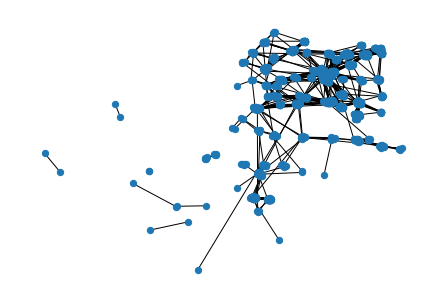

In [ ]:
nx.draw(G_bike,pos=pos_bike,node_size=40)

Use network analysis on the shared bike network

In [ ]:
# calculate the eigenvector_centrality

eigenvector_centrality_map = nx.algorithms.centrality.eigenvector_centrality(G_bike,max_iter=500,weight='weight')
print(eigenvector_centrality_map)

{'31.30629,121.51383': 3.861950542648041e-14, '31.30368,121.50973': 3.861950542648041e-14, '31.27995,121.50016': 1.4512981521709234e-15, '31.27495,121.50114': 1.4512981521709234e-15, '31.31174,121.47998': 3.861950542648041e-14, '31.30466,121.48318': 3.861950542648041e-14, '31.3063,121.48414': 1.5197279260404952e-14, '31.31052,121.47944': 1.5197279260404952e-14, '31.33058,121.53261': 1.5197279260404952e-14, '31.3302,121.5335': 1.5197279260404952e-14, '31.31773,121.47297': 3.861950542648041e-14, '31.32052,121.48275': 3.861950542648041e-14, '31.31153,121.49214': 1.5197279260404952e-14, '31.30703,121.48611': 1.5197279260404952e-14, '31.31125,121.49237': 5.180141064129546e-15, '31.30537,121.48565': 5.180141064129546e-15, '31.30218,121.50605': 3.06133228191062e-16, '31.3044,121.51285': 3.06133228191062e-16, '31.30454,121.50439': 1.5197279260404952e-14, '31.30275,121.51349': 1.5197279260404952e-14, '31.31923,121.48241': 1.836168265337547e-13, '31.33053,121.47407': 1.836168265337547e-13, '31.3

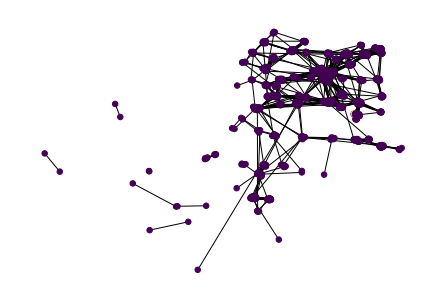

In [ ]:
nx.draw(G_bike,pos=pos_bike,node_size=30,node_color=list(eigenvector_centrality_map.values()))

## Plot it on folium


plot the cluster with high importance, like larger than 0.1


In [ ]:
# all link of a graph
for link in G_bike:
  #print(link)
  link

In [ ]:
# all node importance
for k in eigenvector_centrality_map:
  if eigenvector_centrality_map[k]>=0.1:
      print('coor:',k,', eigenvector:',eigenvector_centrality_map[k])

coor: 31.31744,121.4729 , eigenvector: 0.7071067705763389
coor: 31.32007,121.48368 , eigenvector: 0.7071067705763389


In [ ]:
# todo: plot the data on the folium map

map_bikes = folium.Map(location=[sh_lat,sh_lng],tiles=gaode,attr='test')
# refer to 1.4

for k in eigenvector_centrality_map:
  lnglat = k.split(',') # split the coordiante string into lng and lat
  folium.CircleMarker(
      [float(lnglat[0]), float(lnglat[1])],
      radius=eigenvector_centrality_map[k]*50,
      fill=True
  ).add_to(map_bikes)


map_bikes




so the centers of shanghai are two circles on the map

In eigenvector_centrality, I set the travel time as the weight(by calculate the end_time and start_time)